<h1>Installing and importing necessary libraries</h1>

In [1]:
# Install necessary libraries (only required initially)
!pip install ydata-profiling python-dotenv

In [3]:
# Import necessary libraries
import pandas as pd
import numpy as np
import requests
import time
import os
from dotenv import load_dotenv
from ydata_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns

# Set visualization style for readability
sns.set(style="whitegrid")

<h1>Loading Data</h1>

In [5]:
# Load data into DataFrame
file_path = "/Users/harshithvarma/Cluedln/Company.csv"
df = pd.read_csv(file_path)

In [7]:
# Preview the data
print(df.head())

                              CompanyName  CompanyNumber RegAddress.CareOf  \
0                  BULLDOG MINI SKIPS LTD       15330909               NaN   
1                         BULLDOG LIMITED        9043007               NaN   
2                   BULLDOG MUSHROOMS LTD        8465312               NaN   
3  BULLDOG MUSICAL ENTERTAINMENTS LIMITED        1652098               NaN   
4   BULLDOG NETWORK (BOURNEMOUTH) LIMITED        4667818               NaN   

  RegAddress.POBox                          RegAddress.AddressLine1  \
0              NaN                          YARD 1, ARNOCK BUNGALOW   
1              NaN                                FORESTERS COTTAGE   
2              NaN                  C58-59 NEW COVENT GARDEN MARKET   
3              NaN                            5 RAVENSFIELD GARDENS   
4              NaN  FRP ADVISORY TRADING LIMITED, MOUNTBATTEN HOUSE   

   RegAddress.AddressLine2 RegAddress.PostTown RegAddress.County  \
0   SOUTHEND ARTERIAL ROAD          

In [9]:
# Replace placeholder strings with NaN for consistency
df.replace(['--', 'n/a'], np.nan, inplace=True)

<h1>Data Profiling</h1>

In [12]:
# Initial data profiling to understand dataset structure and issues
initial_profile = ProfileReport(df, title="Initial Company Data Profiling Report")
initial_profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|███████████████████████████████████████████| 55/55 [00:00<00:00, 76.46it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [13]:
# Checking for initial data types
df.dtypes

CompanyName                            object
 CompanyNumber                         object
RegAddress.CareOf                      object
RegAddress.POBox                       object
RegAddress.AddressLine1                object
 RegAddress.AddressLine2               object
RegAddress.PostTown                    object
RegAddress.County                      object
RegAddress.Country                     object
RegAddress.PostCode                    object
CompanyCategory                        object
CompanyStatus                          object
CountryOfOrigin                        object
DissolutionDate                        object
IncorporationDate                      object
Accounts.AccountRefDay                float64
Accounts.AccountRefMonth               object
Accounts.NextDueDate                   object
Accounts.LastMadeUpDate                object
Accounts.AccountCategory               object
Returns.NextDueDate                    object
Returns.LastMadeUpDate            

In [16]:
# Show initial shape of DataFrame
print("Initial shape:", df.shape)

Initial shape: (307, 55)


<h1>Data Cleansing</h1>

In [19]:
# Trim whitespace from column names to avoid mismatches
df.columns = df.columns.str.strip()

In [21]:
# Function to intelligently parse dates from various formats
def smart_parse_date(value):
    try:
        if pd.isnull(value):
            return pd.NaT
        value_str = str(value).strip()

        # Check for numeric date in DDMMYYYY format
        if value_str.isdigit() and len(value_str) == 8:
            return pd.to_datetime(value_str, format="%d%m%Y", errors='coerce')

        # Handle date formats with slashes or dashes
        if "/" in value_str or "-" in value_str:
            return pd.to_datetime(value_str, dayfirst=True, errors='coerce')

        # General fallback for other formats
        return pd.to_datetime(value_str, errors='coerce')
    except:
        return pd.NaT

In [23]:
# List of date-related columns to parse consistently
date_columns = [
    'IncorporationDate', 'DissolutionDate', 'Accounts.NextDueDate',
    'Accounts.LastMadeUpDate', 'Returns.NextDueDate', 'Returns.LastMadeUpDate',
    'ConfStmtNextDueDate', 'ConfStmtLastMadeUpDate'
] + [f'PreviousName_{i}.CONDATE' for i in range(1, 11)]

# Apply date parsing to each relevant column
for col in date_columns:
    if col in df.columns:
        df[col] = df[col].apply(smart_parse_date)

In [25]:
# Convert categorical columns to type 'category' for memory efficiency
category_cols = ['CompanyCategory', 'CompanyStatus', 'CountryOfOrigin', 'Accounts.AccountCategory']
for col in category_cols:
    df[col] = df[col].astype('category')

In [27]:
# Convert numerical columns to nullable integers for accurate numeric representation
numeric_cols = [
    'Accounts.AccountRefDay', 'Accounts.AccountRefMonth', 'Mortgages.NumMortCharges',
    'Mortgages.NumMortOutstanding', 'Mortgages.NumMortPartSatisfied',
    'Mortgages.NumMortSatisfied', 'LimitedPartnerships.NumGenPartners',
    'LimitedPartnerships.NumLimPartners'
]

for col in numeric_cols:
    df[col] = pd.to_numeric(df[col], errors='coerce').astype('Int64')

In [29]:
# Ensure text columns are properly formatted as strings
text_cols = ['CompanyName', 'CompanyNumber', 'RegAddress.CareOf', 'RegAddress.POBox',
             'RegAddress.AddressLine1', 'RegAddress.AddressLine2', 'RegAddress.PostTown',
             'RegAddress.County', 'RegAddress.Country', 'RegAddress.PostCode',
             'URI'] + [f'PreviousName_{i}.CompanyName' for i in range(1, 11)]

for col in text_cols:
    if col in df.columns:
        df[col] = df[col].astype("string")

In [48]:
# Checking for final data types
df.dtypes

CompanyName                           string[python]
CompanyNumber                                 object
RegAddress.CareOf                     string[python]
RegAddress.POBox                      string[python]
RegAddress.AddressLine1               string[python]
RegAddress.AddressLine2               string[python]
RegAddress.PostTown                   string[python]
RegAddress.County                     string[python]
RegAddress.Country                    string[python]
RegAddress.PostCode                   string[python]
CompanyCategory                             category
CompanyStatus                               category
CountryOfOrigin                             category
DissolutionDate                       datetime64[ns]
IncorporationDate                     datetime64[ns]
Accounts.AccountRefDay                         Int64
Accounts.AccountRefMonth                       Int64
Accounts.NextDueDate                  datetime64[ns]
Accounts.LastMadeUpDate               datetime

In [31]:
# Check and remove rows with missing critical identifier 'CompanyNumber' as 'CompanyNumber' is the unique identifier required for API enrichment.
# Without it, we cannot match or retrieve company details reliably.
df.dropna(subset=['CompanyNumber'], inplace=True)

In [33]:
# Standardize CompanyNumber format
# Pad 'CompanyNumber' to ensure it matches Companies House API format (8 digits)
df['CompanyNumber'] = df['CompanyNumber'].astype(str).str.zfill(8)

In [37]:
# Show final shape of DataFrame
print("Final shape:", df.shape)

Final shape: (274, 55)


<h1>Deduplication</h1>

In [35]:
# Identify and remove duplicates based on 'CompanyNumber'
duplicates = df[df.duplicated(subset='CompanyNumber', keep=False)]['CompanyNumber'].unique()
print(f"Duplicates detected: {duplicates}")
df = df[~df['CompanyNumber'].isin(duplicates)].copy()

Duplicates detected: ['05717974' '13067555' '08403564' '11044404' '10141677' '10399598'
 'SC464056' '15139570' '10899619' '15434683' '04466066' '11044170'
 '09084985' '05057638' '15733939' '06590854']


<h1>API Validation</h1>

In [40]:
# Load API key securely from .env file
load_dotenv()
api_key = os.getenv("COMPANIES_HOUSE_API_KEY")
assert api_key, "API Key not found!"

In [42]:
# API URL template for data enrichment
api_url = "https://api.company-information.service.gov.uk/company/{}"

In [44]:
# Function to enrich data using Companies House API
def enrich_company(company_number):
    response = requests.get(api_url.format(company_number), auth=(api_key, ""))
    if response.status_code == 200:
        data = response.json()
        return pd.Series({
            "API_CompanyName": data.get("company_name"),
            "CompanyStatus_Matched": data.get("company_status"),
            "IncorporationDate_Matched": data.get("date_of_creation"),
            "DissolutionDate": data.get("date_of_cessation"),
            "SIC_Code": ", ".join(data.get("sic_codes", [])),
            "Address": ", ".join(filter(None, [
                data["registered_office_address"].get(k, "")
                for k in ["address_line_1", "address_line_2", "locality", "postal_code"]
            ]))
        })
    return pd.Series([np.nan] * 6)

In [46]:
# Enrich dataset with API data
api_results = [enrich_company(num) for num in df['CompanyNumber']]
df_enriched = pd.concat([df.reset_index(drop=True), pd.DataFrame(api_results)], axis=1)

In [50]:
# Enhanced validation with logging
def validate_company_name(row):
    if pd.isnull(row['API_CompanyName']):
        print(f"Validation failed for CompanyNumber: {row['CompanyNumber']} | Reason: No API response")
        return pd.Series({'NameMatch': False, 'ValidationError': 'No API response'})
    elif row['CompanyName'].strip().lower() != row['API_CompanyName'].strip().lower():
        print(f"Validation failed for CompanyNumber: {row['CompanyNumber']} | Reason: Name mismatch")
        return pd.Series({'NameMatch': False, 'ValidationError': 'Name mismatch'})
    else:
        return pd.Series({'NameMatch': True, 'ValidationError': np.nan})

# Apply the validation function
df_enriched[['NameMatch', 'ValidationError']] = df_enriched.apply(validate_company_name, axis=1)

# Rename the original column after validation
df_enriched = df_enriched.rename(columns={"CompanyName": "Original_CompanyName"})

# Separate and display different validation outcomes
api_failures_df = df_enriched[df_enriched['ValidationError'] == 'No API response'].copy()
name_mismatches_df = df_enriched[df_enriched['ValidationError'] == 'Name mismatch'].copy()
valid_matches_df = df_enriched[df_enriched['NameMatch'] == True].copy()

Validation failed for CompanyNumber: 09043007 | Reason: Name mismatch
Validation failed for CompanyNumber: 13732085 | Reason: Name mismatch
Validation failed for CompanyNumber: 14977826 | Reason: Name mismatch
Validation failed for CompanyNumber: 11977850 | Reason: Name mismatch
Validation failed for CompanyNumber: 13575772 | Reason: Name mismatch
Validation failed for CompanyNumber: 13954305 | Reason: Name mismatch
Validation failed for CompanyNumber: 15682855 | Reason: Name mismatch
Validation failed for CompanyNumber: 01005917 | Reason: Name mismatch
Validation failed for CompanyNumber: 09903280 | Reason: Name mismatch
Validation failed for CompanyNumber: 09911779 | Reason: Name mismatch
Validation failed for CompanyNumber: 15682841 | Reason: Name mismatch
Validation failed for CompanyNumber: 12581339 | Reason: Name mismatch
Validation failed for CompanyNumber: OC445344 | Reason: Name mismatch
Validation failed for CompanyNumber: 10062314 | Reason: Name mismatch
Validation failed fo

In [68]:
# Display summaries
print(f"\nAPI Response Failures: {len(api_failures_df)} record(s)")
print(api_failures_df[['CompanyNumber', 'Original_CompanyName', 'ValidationError']].head(2))

print(f"\nName Mismatches: {len(name_mismatches_df)} record(s)")
print(name_mismatches_df[['CompanyNumber', 'Original_CompanyName', 'API_CompanyName', 'ValidationError']].head(2))

print(f"\nValid Matches: {len(valid_matches_df)} record(s)")
print(valid_matches_df[['CompanyNumber', 'Original_CompanyName', 'API_CompanyName']].head(2))


API Response Failures: 1 record(s)
    CompanyNumber    Original_CompanyName  ValidationError
269      05883574  AIRLINE 4 DIALOGUE LTD  No API response

Name Mismatches: 22 record(s)
   CompanyNumber    Original_CompanyName               API_CompanyName  \
1       09043007         BULLDOG LIMITED      BULLDOG MORTLAKE LIMITED   
23      13732085  BULLDOG PROPERTIES LTD  BULLDOG PROPERTIES FYLDE LTD   

   ValidationError  
1    Name mismatch  
23   Name mismatch  

Valid Matches: 251 record(s)
  CompanyNumber    Original_CompanyName         API_CompanyName
0      15330909  BULLDOG MINI SKIPS LTD  BULLDOG MINI SKIPS LTD
2      08465312   BULLDOG MUSHROOMS LTD   BULLDOG MUSHROOMS LTD


In [70]:
print(valid_matches_df.head(2))

     Original_CompanyName CompanyNumber RegAddress.CareOf RegAddress.POBox  \
0  BULLDOG MINI SKIPS LTD      15330909              <NA>             <NA>   
2   BULLDOG MUSHROOMS LTD      08465312              <NA>             <NA>   

           RegAddress.AddressLine1 RegAddress.AddressLine2  \
0          YARD 1, ARNOCK BUNGALOW  SOUTHEND ARTERIAL ROAD   
2  C58-59 NEW COVENT GARDEN MARKET          NINE ELMS LANE   

  RegAddress.PostTown RegAddress.County RegAddress.Country  \
0           BRENTWOOD              <NA>     UNITED KINGDOM   
2                <NA>              <NA>               <NA>   

  RegAddress.PostCode  ...      SIC_Code  \
0            CM13 3TB  ...  38110, 43999   
2             SW8 5JJ  ...         46310   

                                             Address   0   1   2   3   4   5  \
0  Yard 1, Arnock Bungalow, Southend Arterial Roa... NaN NaN NaN NaN NaN NaN   
2  C58-59 New Covent Garden Market, Nine Elms Lan... NaN NaN NaN NaN NaN NaN   

  NameMatch Valid

<h1>Data Visualization</h1>

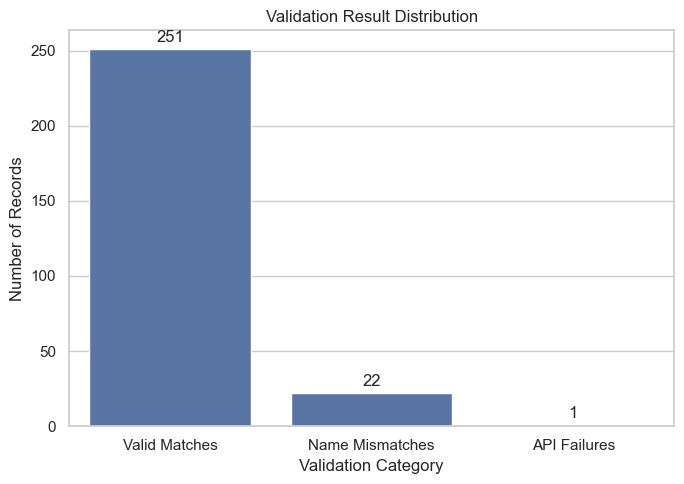

In [72]:
# Visualization of record distribution
match_summary = pd.DataFrame({
    'Category': ['Valid Matches', 'Name Mismatches', 'API Failures'],
    'Count': [len(valid_matches_df), len(name_mismatches_df), len(api_failures_df)]
})

%matplotlib inline

plt.figure(figsize=(7, 5))
ax = sns.barplot(x='Category', y='Count', data=match_summary)
ax.bar_label(ax.containers[0], label_type='edge', padding=3)
plt.title("Validation Result Distribution")
plt.xlabel("Validation Category")
plt.ylabel("Number of Records")
plt.tight_layout()
plt.show()

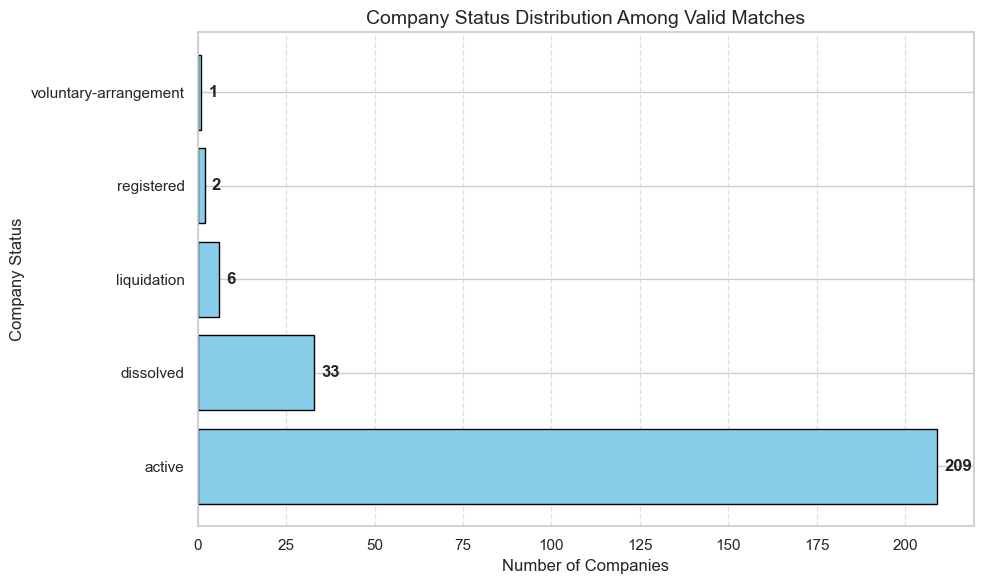

In [74]:
# Visualization of company status distribution

import matplotlib.pyplot as plt

# Get clean counts from the valid_matches_df
status_counts = (
    valid_matches_df['CompanyStatus_Matched']
    .dropna()
    .astype(str)
    .str.strip()
    .value_counts()
)

# Plot manually using matplotlib
plt.figure(figsize=(10, 6))
bars = plt.barh(
    status_counts.index,
    status_counts.values,
    color='skyblue',
    edgecolor='black'
)

# Add labels
for bar in bars:
    width = bar.get_width()
    plt.text(width + 2, bar.get_y() + bar.get_height() / 2,
             str(width), va='center', fontweight='bold')

# Aesthetics
plt.title("Company Status Distribution Among Valid Matches", fontsize=14)
plt.xlabel("Number of Companies", fontsize=12)
plt.ylabel("Company Status", fontsize=12)
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

In [76]:
enriched_count = df_enriched['API_CompanyName'].notna().sum()
print(f"Enrichment Success: {enriched_count} out of {len(df_enriched)} records")

Enrichment Success: 273 out of 274 records


In [78]:
# Final enriched profiling
final_profile = ProfileReport(df_enriched, title="Final Company Data Profiling Report")
final_profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████████████████████████████████████| 69/69 [00:00<00:00, 134.27it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [80]:
# Save final dataset to CSV
df_enriched.to_csv("/Users/harshithvarma/Cluedln/cleaned_enriched_company_data.csv", index=False)
print("Data saved successfully.")

Data saved successfully.
